<a href="https://colab.research.google.com/github/marciusdm/dsnp/blob/main/projeto6_2/ProjetoClassificacaoPyCaret.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

---
<img alt="Colaboratory logo" width="15%" src="https://raw.githubusercontent.com/carlosfab/escola-data-science/master/img/novo_logo_bg_claro.png">

#### **Data Science na Prática 3.0**
*by [Marcius D. Moraes](https://github.com/marciusdm)*  

---
# Prevendo a saúde de fetos com Machine Learning
<center>
<img src="https://github.com/marciusdm/dsnp/blob/main/assets/projeto6_2/uma-mulher-gravida-de-trimestre.jpg?raw=true">
<a href="https://br.freepik.com/fotos-gratis/uma-mulher-gravida-de-trimestre_18641424.htm#query=ultrassom%20gravida&position=13&from_view=keyword&track=ais">Imagem de rawpixel.com</a> no Freepik
</center>

##1. Apresentação
Este projeto tem como objetivo criar um modelo de *machine learning* para classificar o estado de saúde de fetos, com o fim de reduzir as taxas de mortalidade infantil e materna, sendo que grande parte dessas mortes poderia ser evitada se o desenvolvimento do feto fosse monitorado durante o período de gestãção com a realização de exames preventivos. A descoberta precoce de eventuais problemas de saúde da mãe e do feto reduz bastante os riscos inerentes a toda gravidez.  
Um dos exames realizados durante a gestação e que é relativamente simples e barato é chamado de [CardiotocografIa](https://medicalway.com.br/blog/cardiotocografia-entenda-a-importancia-para-a-saude-do-bebe/), também conhecido por sua sigla, CTG. Este exame avalia os sinais vitais do bebê durante as últimas semanas de gestão e indica se há necessidade de se antecipar o parto devido a alguma condição adversa tal como posicionamento inadequado do feto ou cordão umbilical ao redor do pescoço. É um procedimento não invasivo que monitora ao mesmo tempo os movimentos do feto, sua frequência cardíaca e as contrações no útero materno e dura cerca de 20 minutos.

Neste exame são levados em conta as seguintes variáveis:
* Frequência cardíaca fetal basal (FCF) – linha de base:  é a Frequência cardíaca média, avaliada durante um certo intervalo de tempo. A FCF considerada normal é de 110 a 160 batimentos por minuto (bpm);
* Variabilidade:  oscilações ocorridas na frequência cardíaca. Podem ser:
 * microscilações (de curta duração) -  são variações batimento a batimento, detectada somente com CTGs computadorizadas
 * macroscilações,  (variabilidade de longa duração): representa a diferença entre a maior e a menor FCF no intervalo de um minuto de exame
* Aceleração: são aumentos periódicos da FCF devido à atividade motora do feto ou contração uterina
* Desaceleração: quedas periódicas na FCF, podendo ser patológicas ou não. Normalmente estão relacionadas a contrações uterinas, mas também podem ser causadas por compressão no cordão umbilical.

Caso queira saber mais detalhes sobre este exame clique [aqui](https://sogirgs.org.br/area-do-associado/cardiotocografia-anteparto.pdf)


Os dados que serão utilizados neste projeto são de registros extraídos de exames CTG, os quais, são classificados, por obstetras peritos em três possíveis estados:
* Normal;
* Suspeito;
* Patológico.

Conforme descrito em:
> Ayres de Campos et al. (2000) SisPorto 2.0 A Program for Automated Analysis of Cardiotocograms. J Matern Fetal Med 5:311-318

Mais informações sobre estes dados podem ser vistas [aqui](https://www.kaggle.com/datasets/andrewmvd/fetal-health-classification).





## 2. Preprando o ambiente de execução do projeto


### 2.1 Instalações e importações
Primeiramente é necessário instalar as bibliotecas que não estão incluidas no Google Colab e importar os pacotes utilizados.


In [1]:
# instalando as bibliotecas não inclusas no Google Colab
!pip install pycaret -q
!pip install pandas_profiling -q


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 483.9/483.9 kB 6.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.4/34.4 MB 42.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 153.4/153.4 kB 16.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.8/81.8 kB 8.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 13.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.8/106.8 kB 11.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.4/73.4 kB 8.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 65.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.0/44.0 kB 3.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 51.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 50.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.4/10.4 MB 29.4 MB/s e

In [2]:
#importando os pacotes necessários
import pandas as pd
import ydata_profiling as pf
import numpy as np
# importando os pacotes necessConários
from pycaret.classification import setup, compare_models, models, create_model, predict_model
from pycaret.classification import tune_model, plot_model, evaluate_model, finalize_model
from pycaret.classification import save_model, load_model

In [3]:
import seaborn as sns
import matplotlib.pyplot as plt

### 2.2 Obtendo o conjunto de dados


In [4]:
df = pd.read_csv("https://raw.githubusercontent.com/marciusdm/dsnp/main/assets/projeto6_2/fetal_health.csv")
#Vefificando se a obtenção dos dados foi bem sucedida
df.head()

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
0,120.0,0.000,0.0,0.000,0.000,0.0,0.0,73.0,0.5,43.0,...,62.0,126.0,2.0,0.0,120.0,137.0,121.0,73.0,1.0,2.0
1,132.0,0.006,0.0,0.006,0.003,0.0,0.0,17.0,2.1,0.0,...,68.0,198.0,6.0,1.0,141.0,136.0,140.0,12.0,0.0,1.0
2,133.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.1,0.0,...,68.0,198.0,5.0,1.0,141.0,135.0,138.0,13.0,0.0,1.0
3,134.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,11.0,0.0,137.0,134.0,137.0,13.0,1.0,1.0
4,132.0,0.007,0.0,0.008,0.000,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,9.0,0.0,137.0,136.0,138.0,11.0,1.0,1.0


In [ ]:
df.shape

(2126, 22)

## 3. A análise exploratória dos dados
O conjunto de dados acima apresenta 2126 linhas e 22 colunas. Agora é necessário obter mais detalhes, tais como o significado cada coluna e seus respectivos tipos de dados e verificar se existem valores ausentes, analisar correlações entre as colunas.


### 3.1 Dicionário de dados
* **baseline value** (FHR): Freqüência cardíaca fetal basal (FCF);
* **accelerations**: número de acelerações por segundo nos batimentos cardiácos do feto;
* **fetal_movement**: número de movimentos fetais por segundo;
* **uterine_contractions**: número de contrações uterinas por segundo;
* **light_decelerations**: número de desacelerações leves no batimentos cardíacos fetais por segundo;
* **severe_decelerations**: número de desacelerações severas por segundo
* **prolongued_decelerations**: número de desacelerações prolongadas por segundo;
* **abnormal_short_term_variability**: Porcentagem de tempo com variabilidade anormal de curta duração;
* **mean_value_of_short_term_variability**: Valor médio de variabilidade de curta duração;
* **percentage_of_time_with_abnormal_long_term_variability**: Porcentagem de tempo com variação anormal de longa duração;
* **mean_value_of_long_term_variability**:  Valor médio de variabilidade de longa duração
* **histogram_width**: diferença entre o valor mínimo e o valor máximo do histograma de batimentos cardíacos criado para cada registro;
* **histogram_min**: valor mínimo no histograma;
* **histogram_max**: valor máximo no histograma;
* **histogram_number_of_peaks**: número de picos no histograma do exame;
* **histogram_number_of_zeroes**: número de zeros no histograma;
* **histogram_mode**: valor mais frequente no histograma (moda);
* **histogram_mean**: média no histograma;
* **histogram_median**: mediana no histograma;
* **histogram_variance**: variância no histograma;
* **histogram_tendency**: comportamento do histograma. Possíveis valores:
 * -1:  assimetria negativa (mais concentração de valores mais altos);
 * 0: simétrico;
 * 1: assimetria positiva (maior concentração de valores mais baixos);
* **fetal_health**: variável alvo. Valores possíveis:
 * 1: normal
 * 2: suspeito
 * 3: patológico

### 3.2 Verificando os tipos de dados das colunas

In [ ]:
df.dtypes

baseline value                                            float64
accelerations                                             float64
fetal_movement                                            float64
uterine_contractions                                      float64
light_decelerations                                       float64
severe_decelerations                                      float64
prolongued_decelerations                                  float64
abnormal_short_term_variability                           float64
mean_value_of_short_term_variability                      float64
percentage_of_time_with_abnormal_long_term_variability    float64
mean_value_of_long_term_variability                       float64
histogram_width                                           float64
histogram_min                                             float64
histogram_max                                             float64
histogram_number_of_peaks                                 float64
histogram_

### 3.3. Verificando se existem valores nulos

In [ ]:
df.isnull().sum()

baseline value                                            0
accelerations                                             0
fetal_movement                                            0
uterine_contractions                                      0
light_decelerations                                       0
severe_decelerations                                      0
prolongued_decelerations                                  0
abnormal_short_term_variability                           0
mean_value_of_short_term_variability                      0
percentage_of_time_with_abnormal_long_term_variability    0
mean_value_of_long_term_variability                       0
histogram_width                                           0
histogram_min                                             0
histogram_max                                             0
histogram_number_of_peaks                                 0
histogram_number_of_zeroes                                0
histogram_mode                          

Não existem valores nulos no conjunto de dados

### 3.4. Efetuando transformações nos dados
 Antes de prosseguir, a variável alvo será convertida para int por questões de desempenho e praticiadade. Além dela, todas as colunas que só apresentam valores inteiros também serão convertidos para `int`.


In [5]:
df["fetal_health"] = df['fetal_health'].apply(lambda x: int(x))
df["abnormal_short_term_variability"] = df['abnormal_short_term_variability'].apply(lambda x: int(x))
df["percentage_of_time_with_abnormal_long_term_variability"] = df['percentage_of_time_with_abnormal_long_term_variability'].apply(lambda x: int(x))
df["mean_value_of_long_term_variability"] = df['mean_value_of_long_term_variability'].apply(lambda x: int(x))
df["histogram_width"] = df['histogram_width'].apply(lambda x: int(x))
df["histogram_min"] = df['histogram_min'].apply(lambda x: int(x))
df["histogram_number_of_peaks"] = df['histogram_number_of_peaks'].apply(lambda x: int(x))
df["histogram_number_of_zeroes"] = df['histogram_number_of_zeroes'].apply(lambda x: int(x))
df["histogram_mode"] = df['histogram_mode'].apply(lambda x: int(x))
df["histogram_mean"] = df['histogram_mean'].apply(lambda x: int(x))
df["histogram_median"] = df['histogram_median'].apply(lambda x: int(x))
df["histogram_variance"] = df['histogram_variance'].apply(lambda x: int(x))
df["histogram_tendency"] = df['histogram_tendency'].apply(lambda x: int(x))



In [ ]:
df.head()

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
0,120.0,0.000,0.0,0.000,0.000,0.0,0.0,73,0.5,43,...,62,126.0,2,0,120,137,121,73,1,2
1,132.0,0.006,0.0,0.006,0.003,0.0,0.0,17,2.1,0,...,68,198.0,6,1,141,136,140,12,0,1
2,133.0,0.003,0.0,0.008,0.003,0.0,0.0,16,2.1,0,...,68,198.0,5,1,141,135,138,13,0,1
3,134.0,0.003,0.0,0.008,0.003,0.0,0.0,16,2.4,0,...,53,170.0,11,0,137,134,137,13,1,1
4,132.0,0.007,0.0,0.008,0.000,0.0,0.0,16,2.4,0,...,53,170.0,9,0,137,136,138,11,1,1


Verificando novamente os tipos de dados

In [ ]:
df.dtypes

baseline value                                            float64
accelerations                                             float64
fetal_movement                                            float64
uterine_contractions                                      float64
light_decelerations                                       float64
severe_decelerations                                      float64
prolongued_decelerations                                  float64
abnormal_short_term_variability                             int64
mean_value_of_short_term_variability                      float64
percentage_of_time_with_abnormal_long_term_variability      int64
mean_value_of_long_term_variability                         int64
histogram_width                                             int64
histogram_min                                               int64
histogram_max                                             float64
histogram_number_of_peaks                                   int64
histogram_

As colunas que correspondem a números de ocorrências por segundo, como geram números bem próximos de zero, serão convertidas para ocorrências por hora. Para isso, vamos multiplicar cada uma delas por 3600.

In [6]:
df["accelerations"] = df["accelerations"] * 3600
df["fetal_movement"] = df["fetal_movement"] * 3600
df["uterine_contractions"] = df["uterine_contractions"] * 3600
df["light_decelerations"] = df["light_decelerations"] * 3600
df["severe_decelerations"] = df["severe_decelerations"] * 3600
df["prolongued_decelerations"] = df["prolongued_decelerations"] * 3600

In [ ]:
df[["accelerations","fetal_movement","uterine_contractions","light_decelerations","severe_decelerations","prolongued_decelerations"]].sample(n=5, random_state=42)

,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations
282,7.2,36.0,10.8,7.2,0.0,0.0
1999,0.0,3.6,32.4,28.8,0.0,0.0
1709,14.4,10.8,14.4,18.0,0.0,3.6
988,39.6,0.0,18.0,0.0,0.0,0.0
2018,0.0,0.0,28.8,25.2,0.0,3.6


### 3.5. Traçando um panorama geral do conjunto de dados
Utilizando a ferramenta [Pandas Profiling](https://ydata-profiling.ydata.ai/docs/master/index.html) que cria um painel interativo que permite estudar o comportamento de cada coluna e os relacionamentos entre elas.

In [ ]:
# criar ProfileReport
report = pf.ProfileReport(df)

In [ ]:
# criar visualização iframe
report.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Como existe muitas variáveis fica difícil identificar as colunas que mais se relacionam com a variável alvo, por isso mesmo, vamos plotar novamente uma matriz de correlação, porém somente com as 4 colunas que possuem uma correlação maior com `fetal_health`.

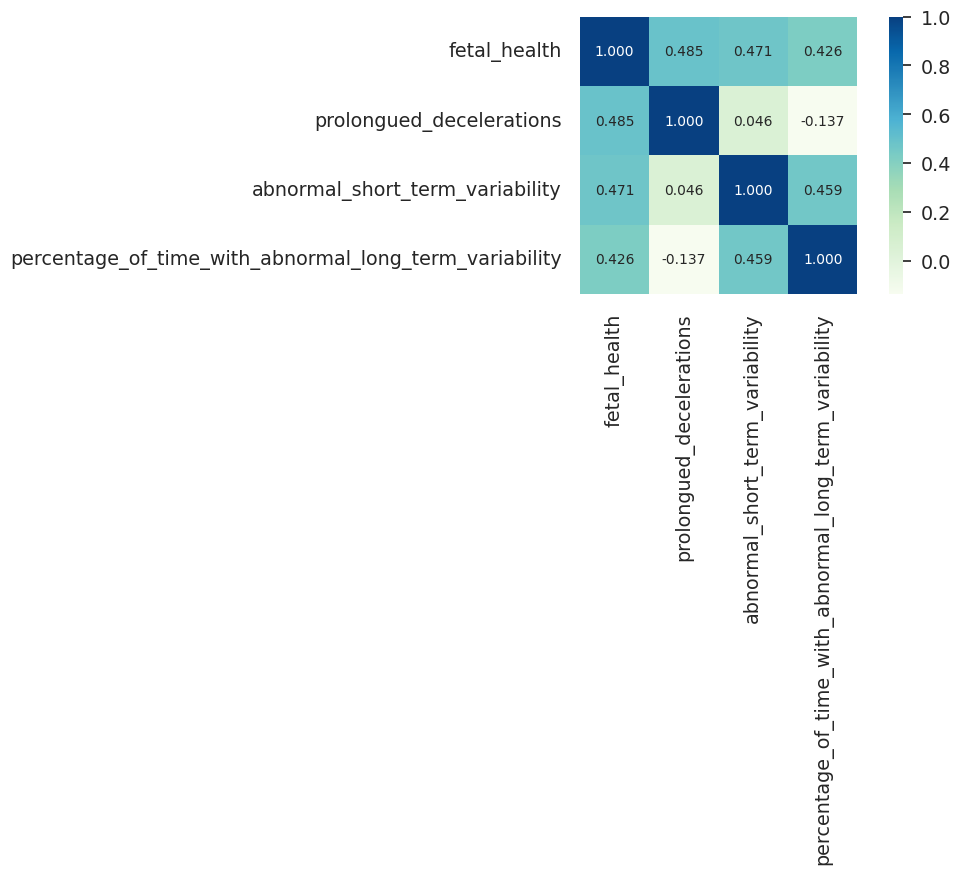

In [ ]:
df_corr = df.corr()
# número de variáveis a serem selecionadas
k = 4

# encontrando as variáveis mais correlacionadas
cols = df_corr.nlargest(k, 'fetal_health')['fetal_health'].index
cm = np.corrcoef(df[cols].values.T)

# plotando o heatmap
f, ax = plt.subplots(figsize=(12, 9))
sns.set(font_scale=1.25)
hm = sns.heatmap(cm, cbar=True, annot=True, square=True, fmt='.3f', annot_kws={'size': 10}, yticklabels=cols.values, xticklabels=cols.values, cmap="GnBu")
plt.tight_layout()

Verifica-se pelo report acima que:

1.  Na maioria dos registros, o feto é considerado saudável (77,8% do total). Portanto, a variável alvo está desbalanceada,  o que ensejará um pré-processamento na base de dados antes de se aplicar os modelos de aprendizado de máquina;
2.   Não existem valores nulos
3. Algumas variávies estão fortemente correlacionadas entre si, como por exemplo `baseline value` com `histogram_mean` e `histogram_median`.


In [ ]:
categorical_columns = ['fetal_health','histogram_tendency','severe_decelerations']
numeric_coluns =  [col for col in df.columns.tolist() if col not in categorical_columns]

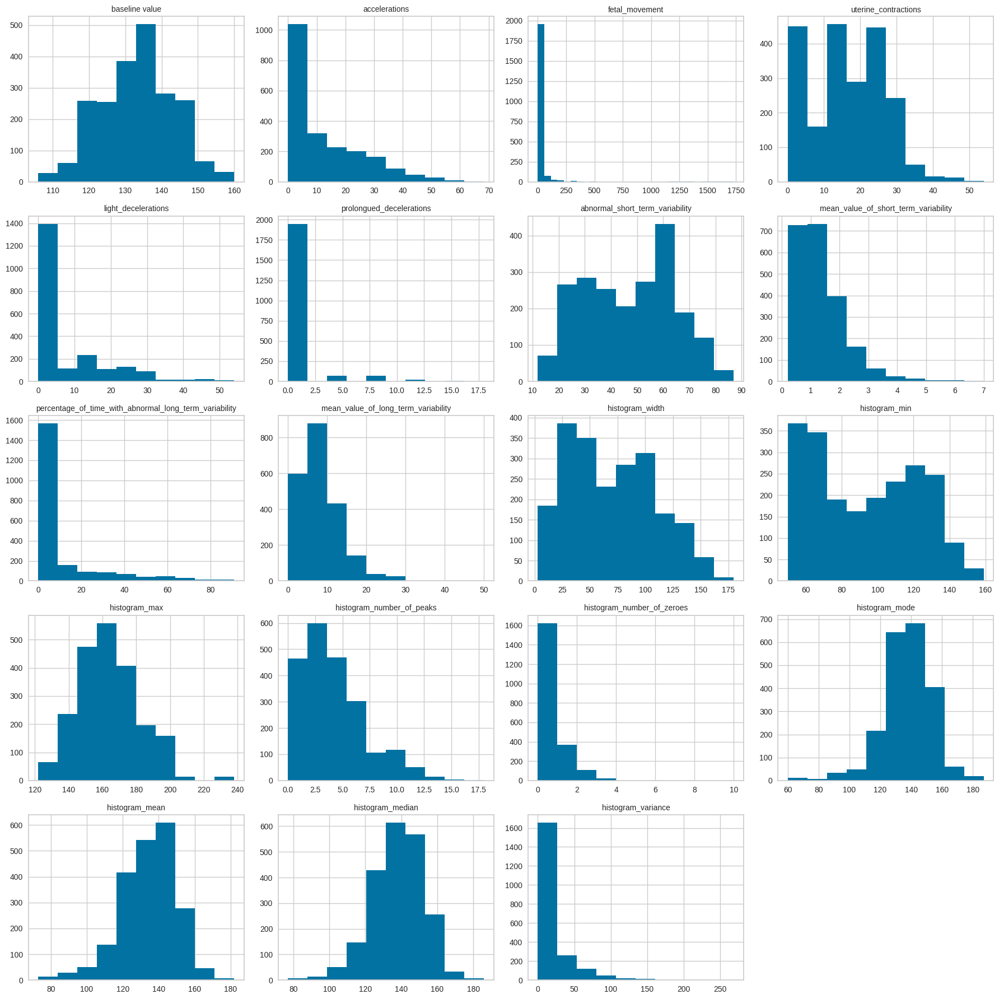

In [ ]:
fig, ax = plt.subplots(nrows=7, ncols=3, figsize=(18,18))
fig.subplots_adjust(hspace=1, wspace=1)

idx = 0
for col in numeric_coluns:
    idx += 1
    plt.subplot(5, 4, idx)
    if idx==3:
      df[col].hist(bins=30)
    else:
      df[col].hist()
    plt.title(col, fontsize=10)
ax1=plt.subplot(5,4,20)
plt.delaxes(ax1)
plt.tight_layout()

In [ ]:
df.head()

,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
0,120.0,0.0,0.0,0.0,0.0,0.0,0.0,73,0.5,43,...,62,126.0,2,0,120,137,121,73,1,2
1,132.0,21.6,0.0,21.6,10.8,0.0,0.0,17,2.1,0,...,68,198.0,6,1,141,136,140,12,0,1
2,133.0,10.8,0.0,28.8,10.8,0.0,0.0,16,2.1,0,...,68,198.0,5,1,141,135,138,13,0,1
3,134.0,10.8,0.0,28.8,10.8,0.0,0.0,16,2.4,0,...,53,170.0,11,0,137,134,137,13,1,1
4,132.0,25.2,0.0,28.8,0.0,0.0,0.0,16,2.4,0,...,53,170.0,9,0,137,136,138,11,1,1


In [ ]:
df[numeric_coluns[0:7]].describe()


,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,prolongued_decelerations,abnormal_short_term_variability
count,2126.000000,2126.000000,2126.000000,2126.000000,2126.000000,2126.000000,2126.000000
mean,133.303857,11.441769,34.130574,15.719097,6.802070,0.570649,46.990122
std,9.840844,13.916127,167.997040,10.605849,10.656751,2.123811,17.192814
min,106.000000,0.000000,0.000000,0.000000,0.000000,0.000000,12.000000
25%,126.000000,0.000000,0.000000,7.200000,0.000000,0.000000,32.000000
50%,133.000000,7.200000,0.000000,14.400000,0.000000,0.000000,49.000000
75%,140.000000,21.600000,10.800000,25.200000,10.800000,0.000000,61.000000
max,160.000000,68.400000,1731.600000,54.000000,54.000000,18.000000,87.000000


In [ ]:
df[numeric_coluns[7:12]].describe()

,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,mean_value_of_long_term_variability,histogram_width,histogram_min
count,2126.000000,2126.00000,2126.000000,2126.000000,2126.000000
mean,1.332785,9.84666,7.760113,70.445908,93.579492
std,0.883241,18.39688,5.598137,38.955693,29.560212
min,0.200000,0.00000,0.000000,3.000000,50.000000
25%,0.700000,0.00000,4.000000,37.000000,67.000000
50%,1.200000,0.00000,7.000000,67.500000,93.000000
75%,1.700000,11.00000,10.000000,100.000000,120.000000
max,7.000000,91.00000,50.000000,180.000000,159.000000


In [ ]:
df[numeric_coluns[12:]].describe()

,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance
count,2126.000000,2126.000000,2126.000000,2126.000000,2126.000000,2126.000000,2126.000000
mean,164.025400,4.068203,0.323612,137.452023,134.610536,138.090310,18.808090
std,17.944183,2.949386,0.706059,16.381289,15.593596,14.466589,28.977636
min,122.000000,0.000000,0.000000,60.000000,73.000000,77.000000,0.000000
25%,152.000000,2.000000,0.000000,129.000000,125.000000,129.000000,2.000000
50%,162.000000,3.000000,0.000000,139.000000,136.000000,139.000000,7.000000
75%,174.000000,6.000000,0.000000,148.000000,145.000000,148.000000,24.000000
max,238.000000,18.000000,10.000000,187.000000,182.000000,186.000000,269.000000


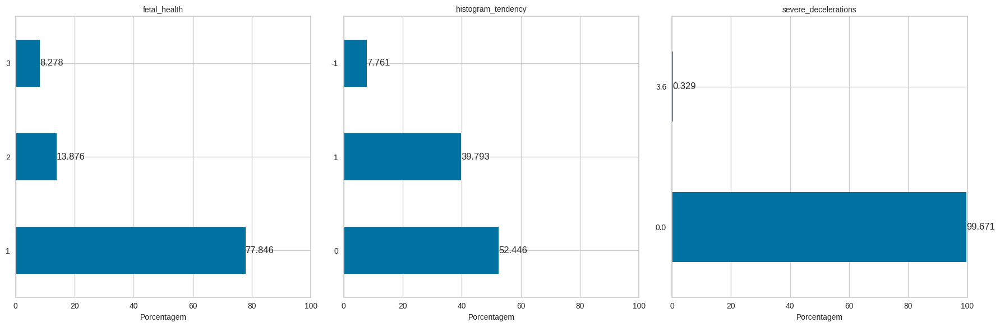

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(18,6))
idx = 0
for col in categorical_columns:
    idx += 1
    plt.subplot(1, 3, idx)
    values = df[col].value_counts()*100/df.shape[0]
    ax= values.plot.barh()
    ax.bar_label(ax.containers[0],fmt="%.3f")
    ax.set_xlim(0,100)
    plt.title(col, fontsize=10)
    plt.xlabel('Porcentagem',fontsize=10)
#f"{height:.0%}"
#fig.subplots_adjust(hspace=1, wspace=1)
plt.tight_layout()



### 3.6. Observando diferenças nos perfis de casos saudáveis, suspeitos e patológicos
Agora será plotado em gráfico que mostra o comportamento das variáveis de acordo com o estado do feto.


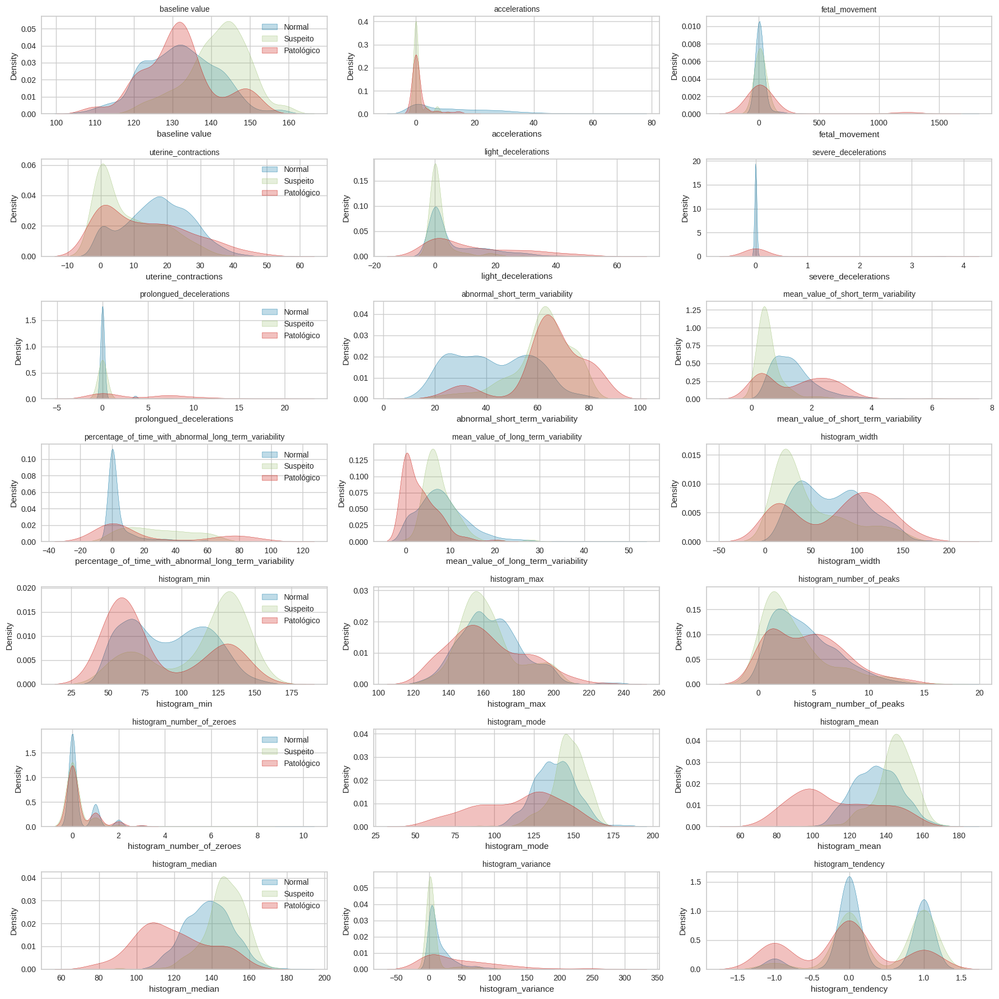

In [ ]:
column_names = df.drop(['fetal_health'], axis=1).columns
num_plots = len(column_names)
df_fetal_health_1 = df[df.fetal_health == 1]
df_fetal_health_2 = df[df.fetal_health == 2]
df_fetal_health_3 = df[df.fetal_health == 3]

fig, ax = plt.subplots(nrows=7, ncols=3, figsize=(18,18))
fig.subplots_adjust(hspace=1, wspace=1)

idx = 0
for col in column_names:
    idx += 1
    plt.subplot(7, 3, idx)
    #sns.kdeplot(df,x=col, hue="Class", fill=True)
    sns.kdeplot(df_fetal_health_1[col], label="Normal", fill=True,)
    sns.kdeplot(df_fetal_health_2[col], label="Suspeito", fill=True)
    sns.kdeplot(df_fetal_health_3[col], label="Patológico", fill=True)
    plt.title(col, fontsize=10)
    if( idx %3  ==1):
      plt.legend()
plt.tight_layout()


Pelos gráficos acima pode-se observar que são indícios fortes de haver alguma patologia no feto:
* não possuir acelerações nos batimentos cardíacos ( repare no gráfico correspondente à variável `accelerations` os casos patológicos e suspeitos estão com valores concentrados próximos de zero);
* apresentar desacelerações;
* variabilidade anormal nos batimentos;
* apresentar poucas contrações uterinas;
*  grandes variações nos batimentos cardíacos, indicados pala variável `histogram_variance`

Além disso, registros tidos como suspeitos apresentam batimentos cardíacos mais acelerados como se pode atestar pelos gráficos das variáveis `histogram_mean` e `histogram_median`. Repare que a média e a mediana são maiores nestes casos.

## 4. Construindo modelos de machine learning
Será feita agora a construção de modelos de machine learning para tentar prever o estado de saúde dos bebês. Para isso será utilizada a ferramenta [PyCaret](https://pycaret.gitbook.io/docs/) que, com poucas linhas de código faz a geração de vários modelos de ML e faz uma comparação entre eles. Também efetua todo o pré-processamento dos dados, incluido normalização e balanceamento dos dados, e também faz ajuste fino dos hiperparâmetros.


### 4.1 Dividindo o conjunto de dados em treino e teste
Como em todo projeto que utiliza aprendizado de máquima deve-se fazer a divisão do conjunto de dados em treino e teste. Aqui 15% dos dados serão destinados a teste

In [7]:
# separando os dados em teste e treino
test = df.sample(frac=0.10, random_state=1, ) #random_state é para garantir a repetibilidade dos testes
train = df.drop(test.index)

test.reset_index(inplace=True, drop=True)
train.reset_index(inplace=True, drop=True)

In [8]:
## Verificando os tamanhos dos conjuntos de dados
# verificando o formato dos conjuntos
print(train.shape)
print(test.shape)

(1913, 22)
(213, 22)


### 4.2 Configurando o PyCaret
A função `setup`abaixo configura o ambiente de execução do PyCaret e configura uma sequência de procedimentos que deixa os dados pronto para uso pelos modelos de aprendizado de máquina. Dois são os parâmetros obrigatórios deste método. O conjunto de dados e variável alvo, sobre a qual será feita as previsões.



In [9]:
# configurando o ambiente
# O parâmetro session_id serve apenas para garantir que os resultados obtidos são sempre os mesmos a cada execução
reg = setup(data = train, target = 'fetal_health',
            transformation = True,
            fix_imbalance = True,
            session_id=1)

,Description,Value
0,Session id,1
1,Target,fetal_health
2,Target type,Multiclass
3,Target mapping,"1: 0, 2: 1, 3: 2"
4,Original data shape,"(1913, 22)"
5,Transformed data shape,"(3709, 22)"
6,Transformed train set shape,"(3135, 22)"
7,Transformed test set shape,"(574, 22)"
8,Numeric features,21
9,Preprocess,True


Repare que o conjunto de dados ficou maior, isto porque o método de balanceamento utilizado cria registros novos das classes minoritárias. Observe também que, pelo item `target mapping`,  o PyCaret converteu os valores da coluna alvo (`fetal_health), sendo que o valor 1 (normal) foi convertido para 0, 2 (patológico) para 1 e 3 (suspeito) foi convertido 2.

### 4.3 Comparando os modelos de machine learning
Invocando a função `compare_models`do PyCaret é possível gerar e comparar diversos modelos de classificação

In [ ]:
best = compare_models(sort="Accuracy")

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.9387,0.9817,0.8704,0.8864,0.8740,0.8287,0.8302,3.9980
xgboost,Extreme Gradient Boosting,0.9380,0.9818,0.8692,0.8793,0.8713,0.8273,0.8286,0.5510
gbc,Gradient Boosting Classifier,0.9320,0.9780,0.8861,0.8687,0.8738,0.8169,0.8189,4.1230
rf,Random Forest Classifier,0.9238,0.9805,0.8650,0.8514,0.8557,0.7935,0.7951,0.9760
et,Extra Trees Classifier,0.9216,0.9755,0.8511,0.8562,0.8503,0.7817,0.7834,0.4630
dt,Decision Tree Classifier,0.9044,0.8945,0.8472,0.8244,0.8306,0.7473,0.7504,0.3120
ada,Ada Boost Classifier,0.8693,0.8406,0.8311,0.7885,0.8003,0.6667,0.6719,0.6220
lda,Linear Discriminant Analysis,0.8573,0.9514,0.8321,0.7621,0.7802,0.6657,0.6832,0.3440
ridge,Ridge Classifier,0.8469,0.0000,0.8092,0.7510,0.7635,0.6417,0.6586,0.1610
dummy,Dummy Classifier,0.7804,0.5000,0.3910,0.3058,0.3432,0.0000,0.0000,0.1790


Processing:   0%|          | 0/65 [00:00<?, ?it/s]

In [ ]:
print(best)

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=1, reg_alpha=0.0, reg_lambda=0.0, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)


O melhor modelo foi o Light Gradient Boosting Machine, então será criada uma instância deste modelo e executá-lo

## 5. Aplicando o melhor modelo


### 5.1 Criando uma instância do modelo LightGBM

In [10]:
lightgbm = create_model('lightgbm')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9254,0.9847,0.8000,0.8000,0.8000,0.7987,0.7987
1,0.9478,0.9913,0.8621,0.8321,0.8443,0.8576,0.8581
2,0.9627,0.9700,0.9627,0.9625,0.9625,0.8953,0.8955
3,0.9552,0.9876,0.9552,0.9619,0.9566,0.8790,0.8808
4,0.9254,0.9832,0.9254,0.9245,0.9236,0.7812,0.7842
5,0.9552,0.9775,0.9552,0.9549,0.9539,0.8728,0.8741
6,0.9552,0.9848,0.9552,0.9553,0.9541,0.8764,0.8777
7,0.9254,0.9845,0.7333,0.8476,0.7833,0.7882,0.7915
8,0.9478,0.9855,0.9000,0.8429,0.8692,0.8632,0.8640


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

### 5.2 Efetuando um tuning do modelo

In [ ]:
tuned_lightgbm = tune_model(lightgbm,optimize="Accuracy")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9179,0.9879,0.8667,0.7431,0.7997,0.7921,0.7958
1,0.9328,0.9900,0.8276,0.7956,0.8088,0.8169,0.8174
2,0.9478,0.9675,0.9478,0.9473,0.9474,0.8533,0.8535
3,0.9776,0.9921,0.9776,0.9808,0.9782,0.9396,0.9408
4,0.9403,0.9858,0.9403,0.9421,0.9409,0.8392,0.8399
5,0.9328,0.9713,0.9328,0.9365,0.9341,0.8214,0.8229
6,0.9552,0.9862,0.9552,0.9575,0.9555,0.8797,0.8802
7,0.9179,0.9884,0.7000,0.8410,0.7591,0.7639,0.7690
8,0.9403,0.9821,0.9333,0.8264,0.8763,0.8473,0.8499


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


O modelo original se saiu melhor que os ajustados, como a acurácia de 93,3% obtida com o LightGBM é um resultado bastante expressivo. Não há necessidde de testar outros modelos.

## 6. Visualizando o modelo vencedor
Esta etapa consiste em visualizar os dados obtidos com o LightGBM. Será plotada a matriz de confusão e a Área Sobre a Curva (AUC)

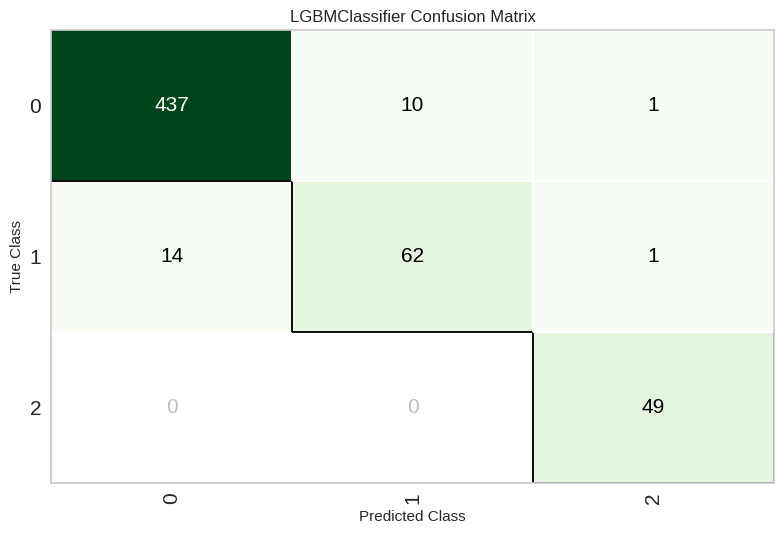

In [ ]:
plot_model(lightgbm,'confusion_matrix')

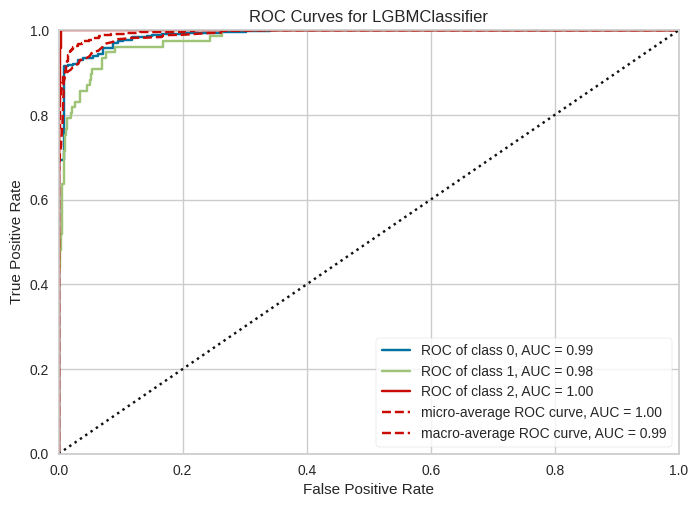

In [ ]:
plot_model(lightgbm,'auc')

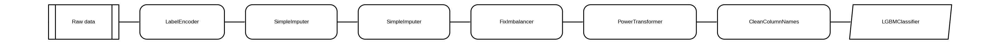

In [ ]:
plot_model(lightgbm,'pipeline')

In [ ]:
plot_model(lightgbm, 'parameter')

,Parameters
boosting_type,gbdt
class_weight,None
colsample_bytree,1.0
importance_type,split
learning_rate,0.1
max_depth,-1
min_child_samples,20
min_child_weight,0.001
min_split_gain,0.0
n_estimators,100


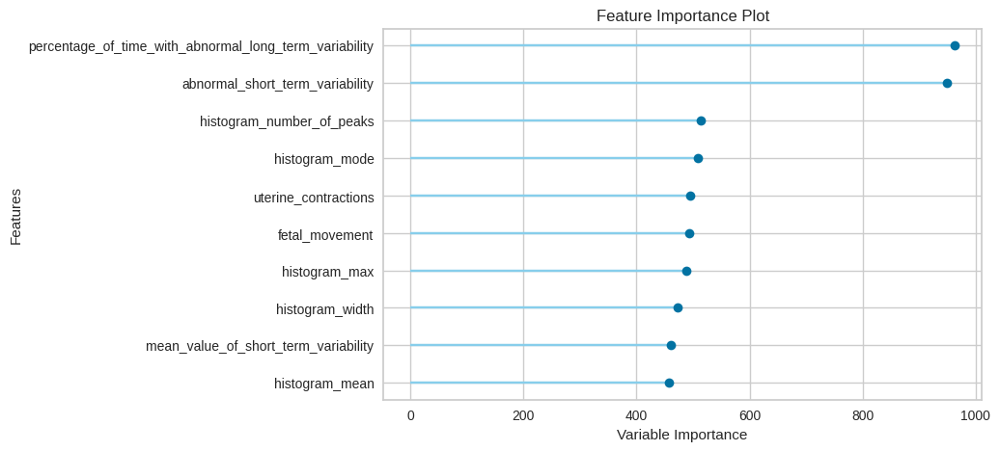

In [ ]:
plot_model(lightgbm,'feature')

## 7. Fazendo previsões
Agora, chegou o momento de testar o modelo escolhido, para fazer previsões nos dados que foram separados logo no começo do projeto e com os quais o modelo ainda não teve contato. Mas antes, será feita uma verificação final com intuido de medier novamente as métricas de desempenho e comparar com  aquelas obtidas durante a validação cruzada. Após será feita uma uma operação que é conhecida como "finalização do modelo", que basicamente, faz o treinamento do modelo em todo o conjunto de testes antes de colocá-lo em produção.
### 7.1 Verificação final

In [ ]:
predict_model(lightgbm)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9547,0.9895,0.9547,0.9538,0.9541,0.8746,0.8748


,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health,prediction_label,prediction_score
356,143.0,0.000000,0.000000,7.200000,0.000000,0.0,0.0,46,0.9,0,...,5,1,150,147,149,4,1,0,1,0.9990
606,138.0,0.000000,0.000000,18.000000,0.000000,0.0,0.0,65,0.4,14,...,3,0,141,140,142,1,0,1,2,0.9977
1183,128.0,0.000000,43.200001,18.000000,25.200001,0.0,7.2,22,2.3,0,...,9,0,143,121,130,97,0,0,1,0.9995
1267,145.0,0.000000,0.000000,28.799999,0.000000,0.0,0.0,57,0.6,10,...,4,0,149,149,150,1,1,0,1,0.9428
345,129.0,32.400002,126.000000,10.800000,0.000000,0.0,0.0,41,1.1,0,...,4,1,133,147,142,60,0,0,1,1.0000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1675,138.0,61.200001,0.000000,14.400000,0.000000,0.0,0.0,51,0.9,0,...,4,0,147,149,150,5,0,0,1,1.0000
1447,140.0,0.000000,0.000000,21.600000,0.000000,0.0,0.0,42,1.4,16,...,1,0,151,150,151,4,0,1,1,0.9472
1131,119.0,14.400000,0.000000,25.200001,3.600000,0.0,0.0,23,1.5,5,...,1,1,126,122,125,9,1,0,1,1.0000
189,124.0,18.000000,54.000000,7.200000,0.000000,0.0,0.0,46,0.8,0,...,4,0,129,130,131,2,1,0,1,1.0000


A acurácia com o modelo executando sobre os dados de teste ficou em 95,4 %. Um pouco maior que o obtido durante o processo de validação cruzada, que ficou em 94,6%. Isto indica que o modelo está bem ajustado aos dados.


## 8. Finalizando o modelo
A parte de finalização de modelo serve para treinar o modelo em todo o conjunto de dados


In [11]:
final_model = finalize_model(lightgbm)

In [ ]:
print(final_model)

Pipeline(memory=Memory(location=None),
         steps=[('label_encoding',
                 TransformerWrapperWithInverse(exclude=None, include=None,
                                               transformer=LabelEncoder())),
                ('numerical_imputer',
                 TransformerWrapper(exclude=None,
                                    include=['baseline value', 'accelerations',
                                             'fetal_movement',
                                             'uterine_contractions',
                                             'light_decelerations',
                                             'severe_decelerations',
                                             'prolongued_deceleratio...
                 LGBMClassifier(boosting_type='gbdt', class_weight=None,
                                colsample_bytree=1.0, importance_type='split',
                                learning_rate=0.1, max_depth=-1,
                                min_child_sample

Por fim, o modelo será testado nos dados de teste separados no início da etapa 4:

In [24]:
# previsão em dados não vistos
unseen_predictions = predict_model(final_model, data=test)
#Exibindo somenta as 6 primeiras e as 3 últimas colunas
unseen_predictions.iloc[:,[0,1,2,3,4,5,21,22,23]].sample(n=10)


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9577,0.9934,0.9577,0.9587,0.9566,0.8879,0.8897


,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,fetal_health,prediction_label,prediction_score
108,133.0,0.0,32.400002,18.000000,0.0,0.0,0,1,0.8551
191,133.0,0.0,0.000000,25.200001,3.6,0.0,0,1,0.9995
106,114.0,0.0,0.000000,28.799999,0.0,0.0,0,1,0.9997
107,130.0,14.4,0.000000,28.799999,3.6,0.0,0,1,1.0000
51,110.0,14.4,3.600000,7.200000,3.6,0.0,0,1,0.9999
33,122.0,14.4,0.000000,21.600000,21.6,0.0,0,1,1.0000
59,149.0,36.0,0.000000,28.799999,0.0,0.0,0,1,0.9999
152,150.0,0.0,0.000000,0.000000,0.0,0.0,1,2,0.8672
4,143.0,0.0,0.000000,3.600000,0.0,0.0,0,1,0.9974
31,136.0,3.6,0.000000,14.400000,0.0,0.0,0,1,1.0000


A acurácia ficou em 95,7%, não muito diferente do valor obtido ao treinar o modelo nos dados de teste, indicando que o moelo é adequado para este conjunto de dados.

## 9. Salvando o modelo
Por fim, o modelo será salvo de modo a utilizá-lo posteriormente para novas previsões. A biblioteca PyCaret inclusive oferece suporte para as plataformas AWS, Google Cloud e Microsoft Azure, permitindo salvar seu modelo em nuvem.

In [ ]:
# salvando o modelo
save_model(final_model,'Modelo_Final_2023_10_24')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=Memory(location=None),
          steps=[('label_encoding',
                  TransformerWrapperWithInverse(exclude=None, include=None,
                                                transformer=LabelEncoder())),
                 ('numerical_imputer',
                  TransformerWrapper(exclude=None,
                                     include=['baseline value', 'accelerations',
                                              'fetal_movement',
                                              'uterine_contractions',
                                              'light_decelerations',
                                              'severe_decelerations',
                                              'prolongued_deceleratio...
                  LGBMClassifier(boosting_type='gbdt', class_weight=None,
                                 colsample_bytree=1.0, importance_type='split',
                                 learning_rate=0.1, max_depth=-1,
                                 

## 10. Conclusões
Com o auxílio da biblioteca PyCaret foi possível testar vários modelos de machine learning para classificação. O melhor deles, o LightGBM, obteve uma acurácia de mais de 95%. O que torna a solução de machine learning como uma excelente ferramenta para tentar prever problemas de saúde dos bebês, com índice de acertos bastante alto.